# Temporal Data Exploration

- Clayton Miller (miller.clayton@gmail.com)

This notebook is for understanding what is contained in the '/data/raw/temp_open.csv' file through visualizations

In [18]:
import pandas as pd
import seaborn as sns
import os
import matplotlib.pyplot as plt

In [19]:
%matplotlib inline

Please fill in the following variable with the path on your computer where the repository is contained:

In [20]:
repos_path = "/Users/Clayton/temporal-features-for-buildings/"

In [21]:
temp = pd.read_csv(os.path.join(repos_path,"data/raw/temp_open.csv"), index_col="timestamp", parse_dates=True)

In [22]:
temp.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 40944 entries, 2010-01-01 00:00:00 to 2015-12-31 23:00:00
Columns: 507 entries, PrimClass_Everett to UnivLab_Aoife
dtypes: float64(507)
memory usage: 158.7 MB


In [23]:
temp.head()

,PrimClass_Everett,UnivClass_Clifford,Office_Elizabeth,Office_Ellie,PrimClass_Elisabeth,Office_Cristina,PrimClass_Jolie,PrimClass_Jaylin,Office_Jesus,PrimClass_Esmeralda,...,Office_Pauline,UnivLab_Dianna,UnivDorm_Cecilia,Office_Luann,Office_Milton,Office_Lane,Office_Cameron,UnivLab_Lea,UnivLab_Carlos,UnivLab_Aoife
timestamp,,,,,,,,,,,,,,,,,,,,,
2010-01-01 00:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,763.550,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2010-01-01 01:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,741.625,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2010-01-01 02:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,726.775,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2010-01-01 03:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,715.025,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2010-01-01 04:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,703.600,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


## Get the Meta Data as well to understand the start and stop times and the primary use types of the data

In [48]:
meta = pd.read_csv(os.path.join(repos_path,"data/raw/meta_open.csv"), index_col='uid', parse_dates=["datastart","dataend"], dayfirst=True)

In [49]:
str(meta.ix[:1].dataend[0])

'2012-12-31 23:00:00'

In [50]:
meta.head()

,dataend,datastart,energystarscore,heatingtype,industry,mainheatingtype,numberoffloors,occupants,primaryspaceusage,rating,sqft,sqm,subindustry,timezone,yearbuilt,nickname,primaryspaceuse_abbrev,newweatherfilename
uid,,,,,,,,,,,,,,,,,,
PrimClass_Everett,2012-12-31 23:00:00,2012-01-01,NaN,NaN,Education,NaN,NaN,NaN,Primary/Secondary Classroom,NaN,105530.0,9804.053590,Primary/Secondary School,America/New_York,NaN,Everett,PrimClass,weather12.csv
UnivClass_Clifford,2015-12-31 23:00:00,2015-01-01,NaN,NaN,Education,NaN,NaN,NaN,College Classroom,NaN,56969.0,5292.591007,College/University,America/New_York,1967,Clifford,UnivClass,weather2.csv
Office_Elizabeth,2012-12-31 23:00:00,2012-01-01,NaN,NaN,Commercial Property,NaN,NaN,NaN,Office,NaN,294651.0,27373.961850,Commercial Real Estate,America/Los_Angeles,NaN,Elizabeth,Office,weather22.csv
Office_Ellie,2012-12-31 23:00:00,2012-01-01,NaN,NaN,Commercial Property,NaN,NaN,NaN,Office,NaN,496517.0,46127.918850,Bank/Financial Services,America/Los_Angeles,NaN,Ellie,Office,weather28.csv
PrimClass_Elisabeth,2012-12-31 23:00:00,2012-01-01,NaN,NaN,Education,NaN,NaN,NaN,Primary/Secondary Classroom,NaN,233062.0,21652.158990,Primary/Secondary School,America/New_York,NaN,Elisabeth,PrimClass,weather23.csv


# Plot subplots according to datastart and prim use type

In [51]:
sns.set_style("whitegrid")
sns.set_context(font_scale=1.5)

In [58]:
def plot_buildingtype(meta, temp, primaryusetype):
    for datastarttime in meta.datastart.unique():

        to_plot_info = meta[(meta.primaryspaceuse_abbrev == primaryusetype) & (meta.datastart == datastarttime)]
        to_plot_names = to_plot_info.index.sort_values()
        
        print "Plotting "+primaryusetype+" with start time: "+str(datastarttime)
        print "This includes the following buildings: "+str(list(to_plot_names))
        
        # See if there is any data to be plotted
        try:
            length = len(to_plot_names)
            plotsize = length*2.5

            starttime = datastarttime
            endtime = to_plot_info.dataend.unique()[0]

            to_plot_data = temp[to_plot_names].truncate(before=starttime, after=endtime)

            to_plot_data.plot(subplots=True, figsize=(15,plotsize))
            plt.tight_layout()

            starttimestring = str(datastarttime)
            plt.savefig(os.path.join(repos_path,"reports/figures/overviewlinecharts/"+primaryusetype+"_"+starttimestring[:-19]+".png"))
            plt.show()

        except:
            print "no data to plot"
            continue

In [59]:
meta.primaryspaceuse_abbrev.unique()

array(['PrimClass', 'UnivClass', 'Office', 'UnivDorm', 'UnivLab'], dtype=object)

## Primary/Secondary Schools

Plotting PrimClass with start time: 2012-01-01T00:00:00.000000000
This includes the following buildings: ['PrimClass_Ebony', 'PrimClass_Edmund', 'PrimClass_Edwin', 'PrimClass_Eleanor', 'PrimClass_Eli', 'PrimClass_Elijah', 'PrimClass_Elisabeth', 'PrimClass_Ellen', 'PrimClass_Elliott', 'PrimClass_Elmer', 'PrimClass_Emanuela', 'PrimClass_Emilio', 'PrimClass_Emily', 'PrimClass_Eoghan', 'PrimClass_Ernest', 'PrimClass_Ernesto', 'PrimClass_Ervin', 'PrimClass_Esmeralda', 'PrimClass_Ethan', 'PrimClass_Ethel', 'PrimClass_Eva', 'PrimClass_Everett', 'PrimClass_Evie', 'PrimClass_Ezekiel', 'PrimClass_Ezra']


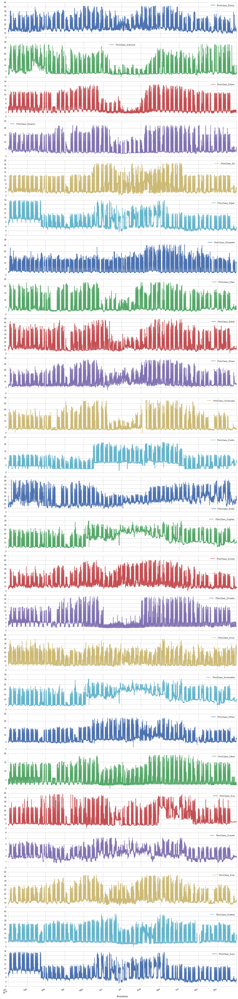

Plotting PrimClass with start time: 2015-01-01T00:00:00.000000000
This includes the following buildings: ['PrimClass_Angel', 'PrimClass_Angela']


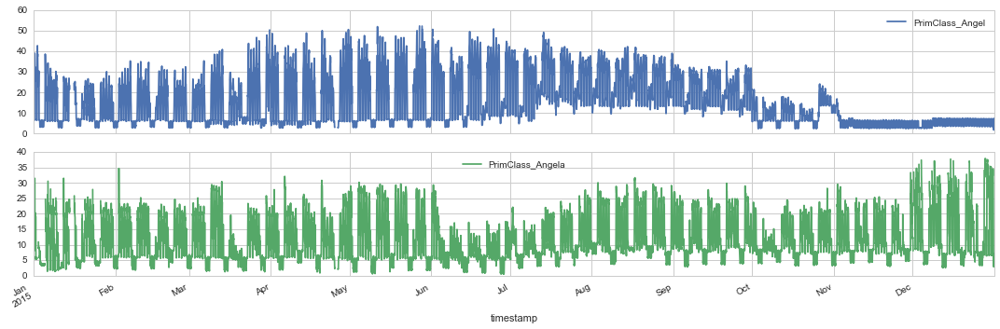

Plotting PrimClass with start time: 2014-12-01T00:00:00.000000000
This includes the following buildings: ['PrimClass_Jacob', 'PrimClass_Jacqueline', 'PrimClass_Jacquelyn', 'PrimClass_Jaden', 'PrimClass_Jaiden', 'PrimClass_Jake', 'PrimClass_Jamal', 'PrimClass_Jamie', 'PrimClass_Jane', 'PrimClass_Janelle', 'PrimClass_Janet', 'PrimClass_Janice', 'PrimClass_Janie', 'PrimClass_Janis', 'PrimClass_Janiya', 'PrimClass_Jaqueline', 'PrimClass_Jarrett', 'PrimClass_Jasmine', 'PrimClass_Javier', 'PrimClass_Jaxson', 'PrimClass_Jayda', 'PrimClass_Jayla', 'PrimClass_Jaylin', 'PrimClass_Jaylinn', 'PrimClass_Jayson', 'PrimClass_Jazmin', 'PrimClass_Jazmine', 'PrimClass_Jean', 'PrimClass_Jeanette', 'PrimClass_Jeanine', 'PrimClass_Jeannine', 'PrimClass_Jediah', 'PrimClass_Jeff', 'PrimClass_Jeffery', 'PrimClass_Jeffrey', 'PrimClass_Jenna', 'PrimClass_Jennie', 'PrimClass_Jennifer', 'PrimClass_Jensen', 'PrimClass_Jeremy', 'PrimClass_Jermaine', 'PrimClass_Jerome', 'PrimClass_Jesse', 'PrimClass_Jessie', 'PrimCl

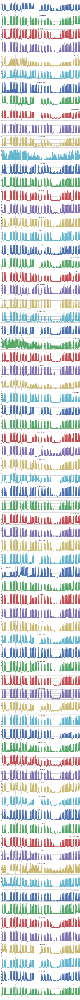

Plotting PrimClass with start time: 2012-02-02T00:00:00.000000000
This includes the following buildings: ['PrimClass_Ulysses', 'PrimClass_Uma', 'PrimClass_Umar', 'PrimClass_Uriah']


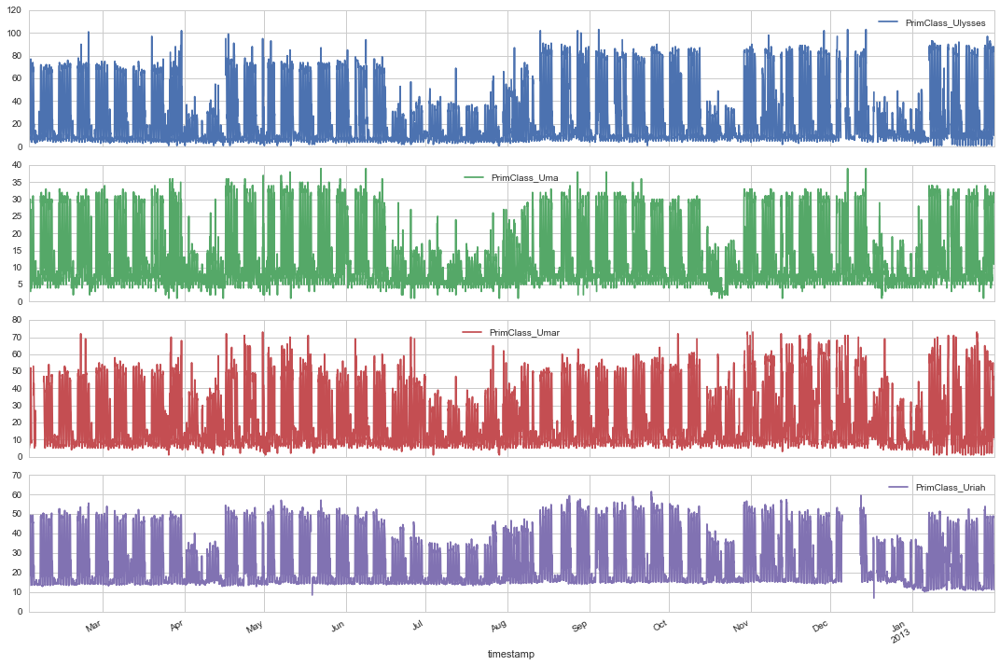

Plotting PrimClass with start time: 2013-01-01T00:00:00.000000000
This includes the following buildings: []
no data to plot
Plotting PrimClass with start time: 2014-05-01T00:00:00.000000000
This includes the following buildings: []
no data to plot
Plotting PrimClass with start time: 2014-11-01T00:00:00.000000000
This includes the following buildings: []
no data to plot
Plotting PrimClass with start time: 2010-01-01T00:00:00.000000000
This includes the following buildings: []
no data to plot


In [60]:
plot_buildingtype(meta, temp, "PrimClass")

# University Classrooms

# plot_buildingtype(meta, temp, "UnivClass")

# University Labs

Plotting UnivLab with start time: 2012-01-01T00:00:00.000000000
This includes the following buildings: ['UnivLab_Bert', 'UnivLab_Beth', 'UnivLab_Bethany', 'UnivLab_Brad', 'UnivLab_Brenna']


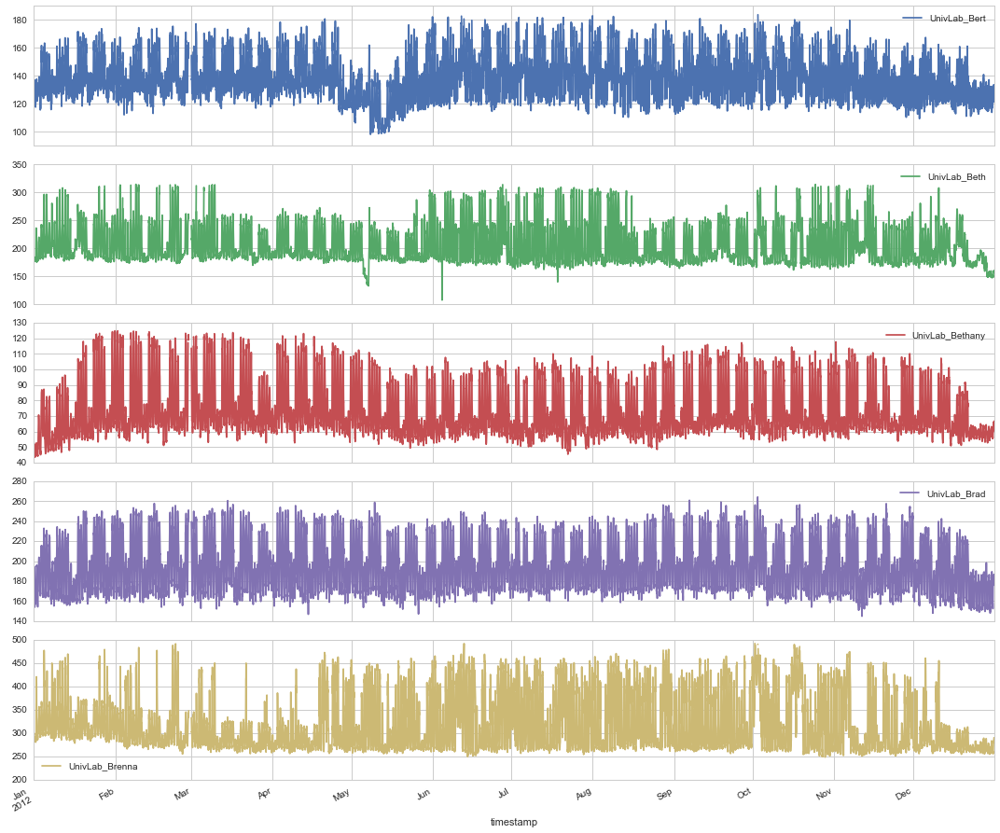

Plotting UnivLab with start time: 2015-01-01T00:00:00.000000000
This includes the following buildings: ['UnivLab_Adrian', 'UnivLab_Aine', 'UnivLab_Alaina', 'UnivLab_Albert', 'UnivLab_Alberto', 'UnivLab_Alexis', 'UnivLab_Alfonso', 'UnivLab_Ali', 'UnivLab_Alina', 'UnivLab_Alisa', 'UnivLab_Allan', 'UnivLab_Allison', 'UnivLab_Amaya', 'UnivLab_Amy', 'UnivLab_Ana', 'UnivLab_Andre', 'UnivLab_Angie', 'UnivLab_Anita', 'UnivLab_Aniya', 'UnivLab_Annabelle', 'UnivLab_Annette', 'UnivLab_Aoife', 'UnivLab_Arianna', 'UnivLab_Ariel', 'UnivLab_Ashlee', 'UnivLab_Ashlynn', 'UnivLab_Ashton', 'UnivLab_Audra', 'UnivLab_Aurora', 'UnivLab_Caesar', 'UnivLab_Caitlin', 'UnivLab_Callie', 'UnivLab_Cam', 'UnivLab_Camryn', 'UnivLab_Carley', 'UnivLab_Carlos', 'UnivLab_Carlton', 'UnivLab_Carol', 'UnivLab_Carole', 'UnivLab_Cayden', 'UnivLab_Cecil', 'UnivLab_Cedric', 'UnivLab_Cesar', 'UnivLab_Cheyanne', 'UnivLab_Christine', 'UnivLab_Christy', 'UnivLab_Ciel', 'UnivLab_Cindy', 'UnivLab_Clint', 'UnivLab_Clodagh', 'UnivLab_C

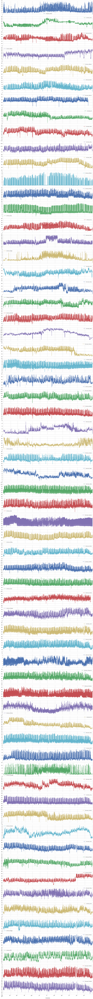

Plotting UnivLab with start time: 2014-12-01T00:00:00.000000000
This includes the following buildings: ['UnivLab_Lauren', 'UnivLab_Lea', 'UnivLab_Lee', 'UnivLab_Lester', 'UnivLab_Levi', 'UnivLab_Lilly', 'UnivLab_Louie', 'UnivLab_Lyle', 'UnivLab_Santiago', 'UnivLab_Susan', 'UnivLab_Suzette']


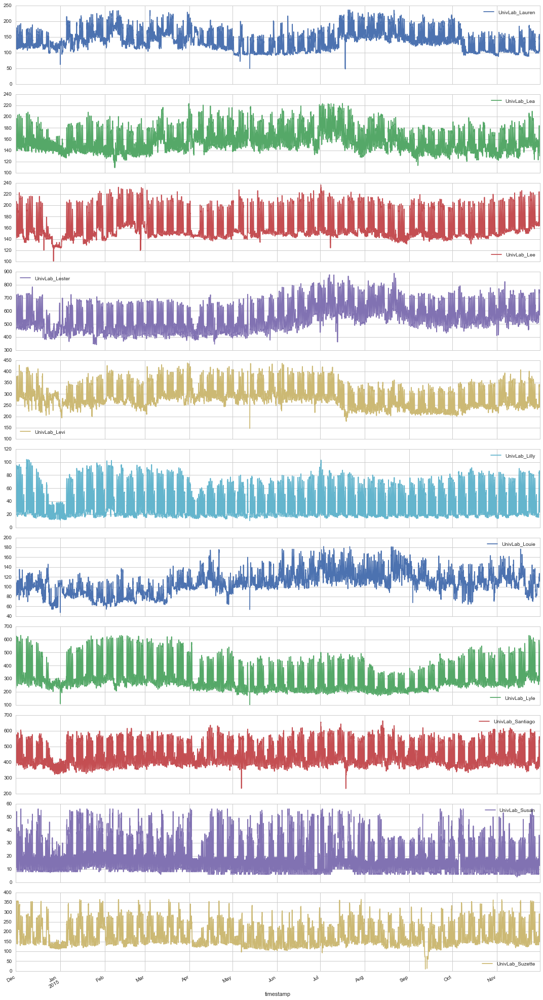

Plotting UnivLab with start time: 2012-02-02T00:00:00.000000000
This includes the following buildings: []
no data to plot
Plotting UnivLab with start time: 2013-01-01T00:00:00.000000000
This includes the following buildings: ['UnivLab_Tami', 'UnivLab_Taylor', 'UnivLab_Terrie', 'UnivLab_Tracie', 'UnivLab_Tracy']


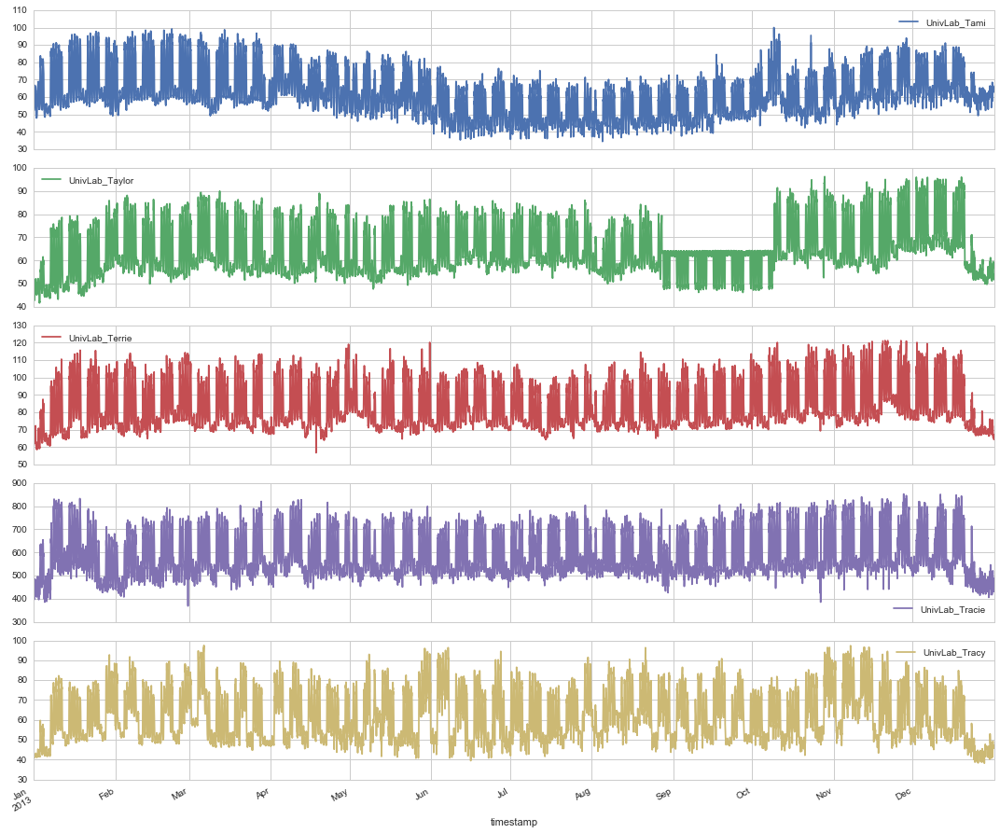

Plotting UnivLab with start time: 2014-05-01T00:00:00.000000000
This includes the following buildings: ['UnivLab_Mack', 'UnivLab_Madelyn', 'UnivLab_Margret', 'UnivLab_Mariana', 'UnivLab_Marie', 'UnivLab_Mario', 'UnivLab_Marshall', 'UnivLab_Miles']


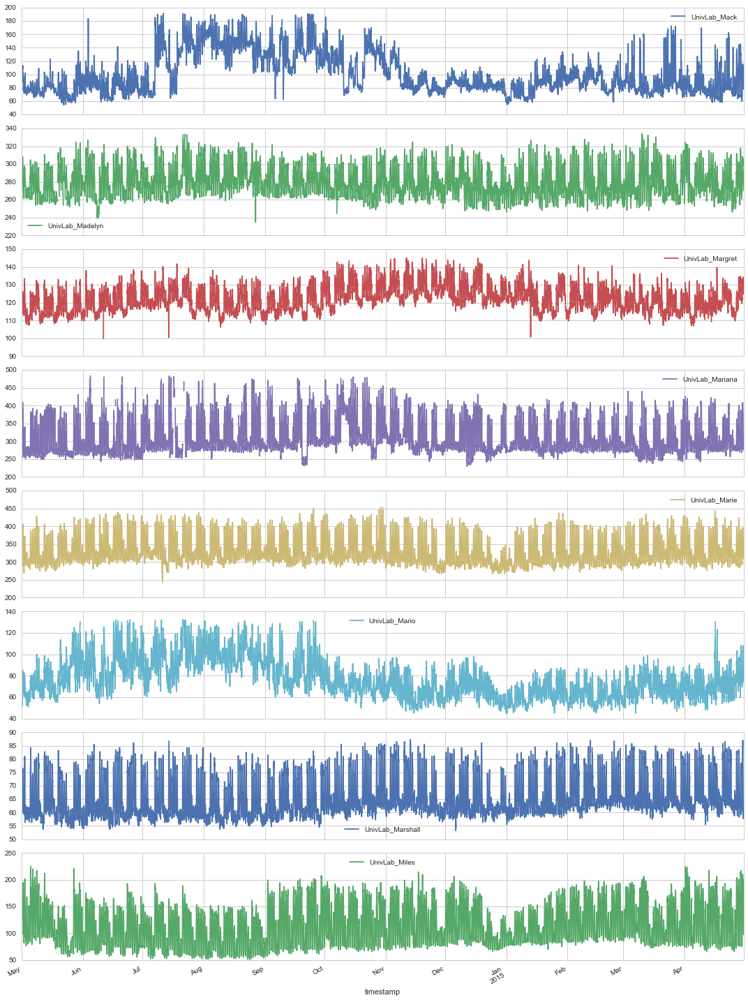

Plotting UnivLab with start time: 2014-11-01T00:00:00.000000000
This includes the following buildings: ['UnivLab_Neil']


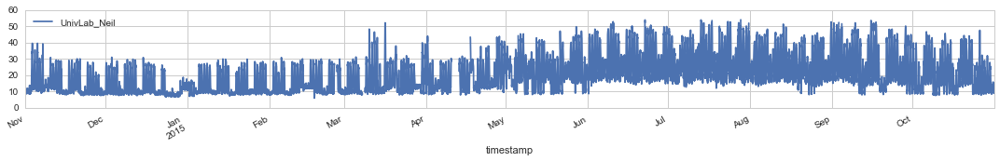

Plotting UnivLab with start time: 2010-01-01T00:00:00.000000000
This includes the following buildings: ['UnivLab_Dianna']


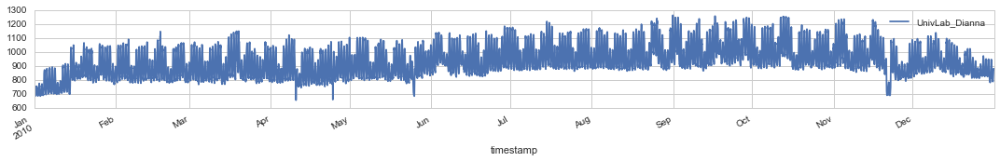

In [62]:
plot_buildingtype(meta, temp, "UnivLab")

# University Dorms

Plotting UnivDorm with start time: 2012-01-01T00:00:00.000000000
This includes the following buildings: []
no data to plot
Plotting UnivDorm with start time: 2015-01-01T00:00:00.000000000
This includes the following buildings: ['UnivDorm_Adan', 'UnivDorm_Adriana', 'UnivDorm_Ahmad', 'UnivDorm_Alex', 'UnivDorm_Alka', 'UnivDorm_Alonzo', 'UnivDorm_Alphonso', 'UnivDorm_Alyshialynn', 'UnivDorm_Alyssa', 'UnivDorm_Antonio', 'UnivDorm_April', 'UnivDorm_Ashleigh', 'UnivDorm_Avery', 'UnivDorm_Camila', 'UnivDorm_Candace', 'UnivDorm_Cara', 'UnivDorm_Carey', 'UnivDorm_Carla', 'UnivDorm_Carter', 'UnivDorm_Casey', 'UnivDorm_Cathal', 'UnivDorm_Cathalina', 'UnivDorm_Cecilia', 'UnivDorm_Celeste', 'UnivDorm_Chelsey', 'UnivDorm_Cheri', 'UnivDorm_Chester', 'UnivDorm_Cheyenne', 'UnivDorm_Christi', 'UnivDorm_Christopher', 'UnivDorm_Cian', 'UnivDorm_Ciaran', 'UnivDorm_Claudia', 'UnivDorm_Clayton', 'UnivDorm_Colton', 'UnivDorm_Constance', 'UnivDorm_Cooper', 'UnivDorm_Corey', 'UnivDorm_Cornelius', 'UnivDorm_Curt

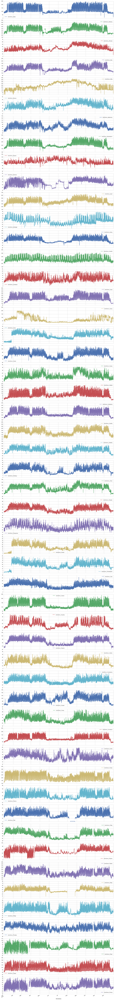

Plotting UnivDorm with start time: 2014-12-01T00:00:00.000000000
This includes the following buildings: ['UnivDorm_Jeannette', 'UnivDorm_Laura', 'UnivDorm_Lawrence', 'UnivDorm_Leann', 'UnivDorm_Leonard', 'UnivDorm_Leslie', 'UnivDorm_Leticia', 'UnivDorm_Lorraine', 'UnivDorm_Lysander']


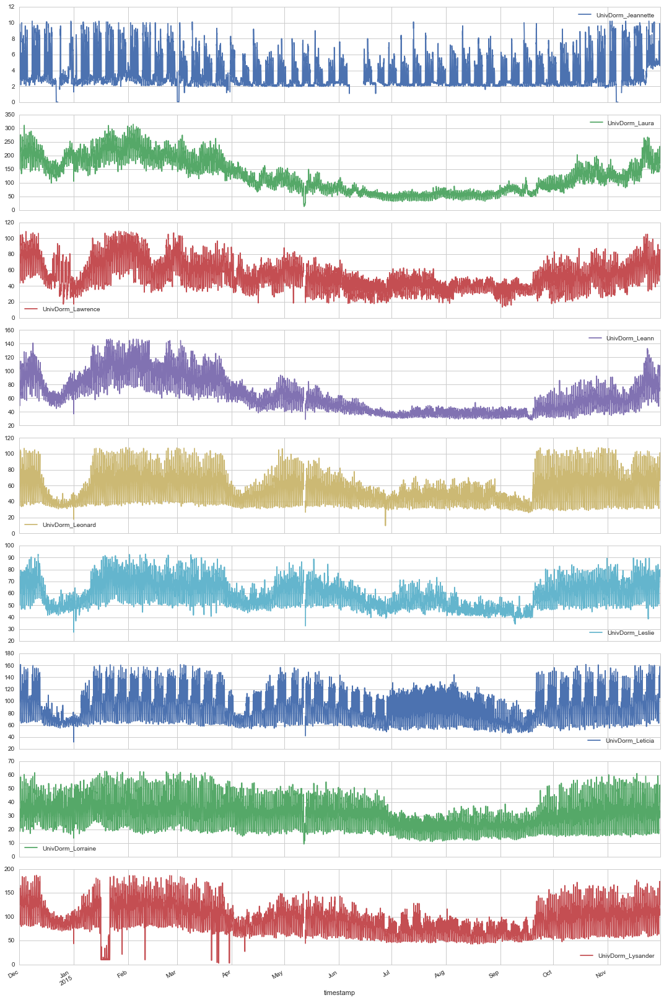

Plotting UnivDorm with start time: 2012-02-02T00:00:00.000000000
This includes the following buildings: ['UnivDorm_Una']


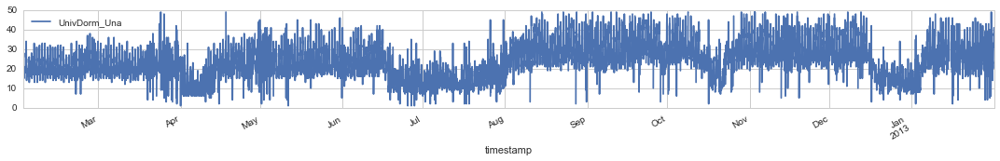

Plotting UnivDorm with start time: 2013-01-01T00:00:00.000000000
This includes the following buildings: []
no data to plot
Plotting UnivDorm with start time: 2014-05-01T00:00:00.000000000
This includes the following buildings: ['UnivDorm_Malachi', 'UnivDorm_Malcolm', 'UnivDorm_Marlene', 'UnivDorm_Marquis', 'UnivDorm_Mathew', 'UnivDorm_Mauricio', 'UnivDorm_Mckenzie', 'UnivDorm_Mitch']


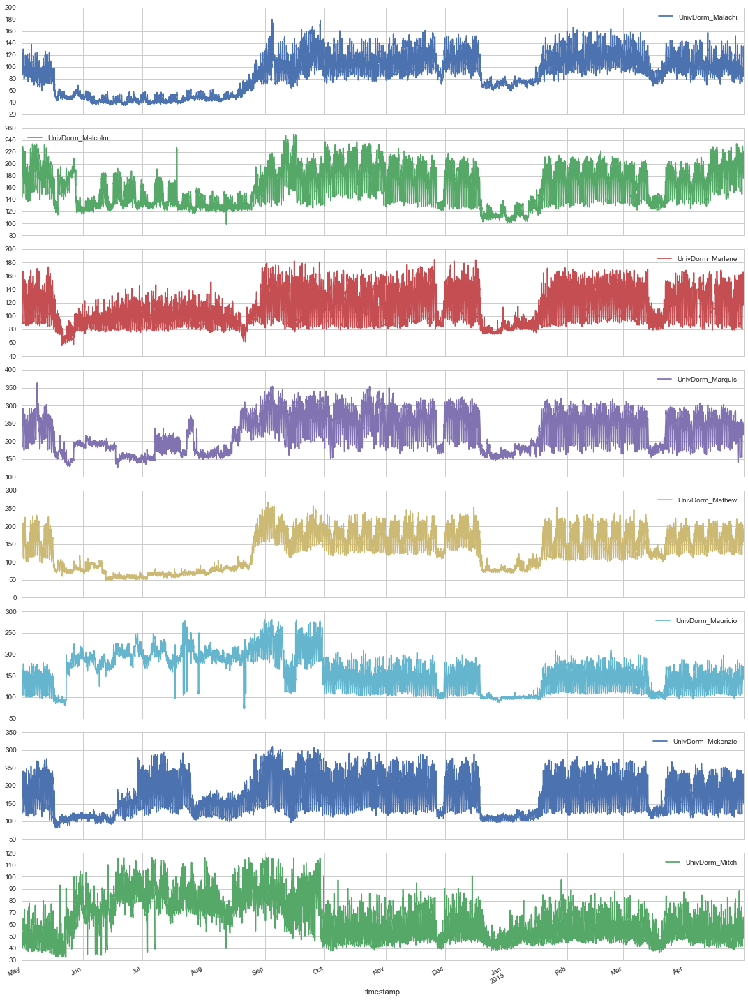

Plotting UnivDorm with start time: 2014-11-01T00:00:00.000000000
This includes the following buildings: []
no data to plot
Plotting UnivDorm with start time: 2010-01-01T00:00:00.000000000
This includes the following buildings: []
no data to plot


In [63]:
plot_buildingtype(meta, temp, "UnivDorm")

# Offices

Plotting Office with start time: 2012-01-01T00:00:00.000000000
This includes the following buildings: ['Office_Benjamin', 'Office_Benthe', 'Office_Bianca', 'Office_Bobbi', 'Office_Brian', 'Office_Bryon', 'Office_Eddie', 'Office_Eileen', 'Office_Elena', 'Office_Elizabeth', 'Office_Ellie', 'Office_Elliot', 'Office_Ellis', 'Office_Emer', 'Office_Emerald', 'Office_Erik', 'Office_Evelyn']


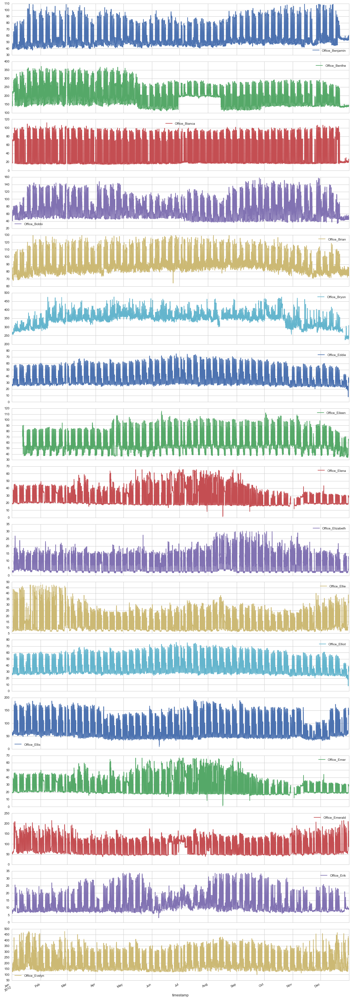

Plotting Office with start time: 2015-01-01T00:00:00.000000000
This includes the following buildings: ['Office_Abbey', 'Office_Abigail', 'Office_Al', 'Office_Alannah', 'Office_Aliyah', 'Office_Allyson', 'Office_Alyson', 'Office_Amelia', 'Office_Amelie', 'Office_Anastasia', 'Office_Andrea', 'Office_Angelica', 'Office_Angelina', 'Office_Angelo', 'Office_Annika', 'Office_Ashanti', 'Office_Asher', 'Office_Aubrey', 'Office_Autumn', 'Office_Ava', 'Office_Ayden', 'Office_Ayesha', 'Office_Caleb', 'Office_Cameron', 'Office_Carissa', 'Office_Carolina', 'Office_Catherine', 'Office_Cecelia', 'Office_Charles', 'Office_Clarissa', 'Office_Clifton', 'Office_Clinton', 'Office_Cody', 'Office_Colby', 'Office_Conrad', 'Office_Cora', 'Office_Corbin', 'Office_Cristina', 'Office_Curt', 'Office_Paige', 'Office_Pam', 'Office_Pamela', 'Office_Pasquale', 'Office_Pat', 'Office_Patricia', 'Office_Paula', 'Office_Paulette', 'Office_Paulina', 'Office_Pauline', 'Office_Penny', 'Office_Perla', 'Office_Phebian', 'Offic

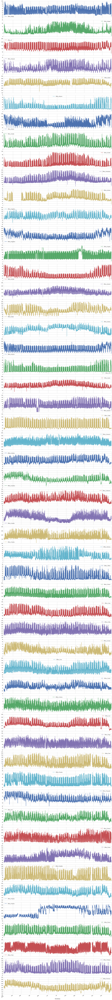

Plotting Office with start time: 2014-12-01T00:00:00.000000000
This includes the following buildings: ['Office_Gabriela', 'Office_Garman', 'Office_Garrett', 'Office_Gemma', 'Office_Georgia', 'Office_Gisselle', 'Office_Gladys', 'Office_Glenda', 'Office_Glenn', 'Office_Gloria', 'Office_Guillermo', 'Office_Gustavo', 'Office_Jackie', 'Office_Jackson', 'Office_Jan', 'Office_Javon', 'Office_Jayden', 'Office_Jeanne', 'Office_Jerry', 'Office_Jesus', 'Office_Jett', 'Office_Joan', 'Office_John', 'Office_Joni', 'Office_Jude', 'Office_Lane', 'Office_Leland', 'Office_Lena', 'Office_Lesa', 'Office_Lillian', 'Office_Louise', 'Office_Luann', 'Office_Scottie', 'Office_Shari', 'Office_Shawnette', 'Office_Shelly', 'Office_Sinead', 'Office_Skyler', 'Office_Stella']


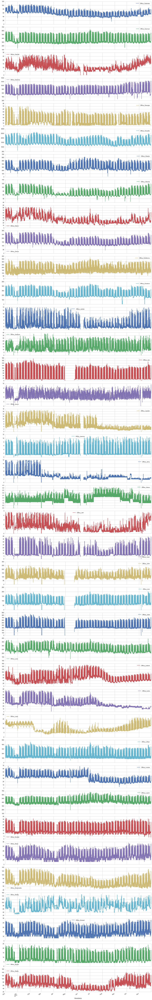

Plotting Office with start time: 2012-02-02T00:00:00.000000000
This includes the following buildings: []
no data to plot
Plotting Office with start time: 2013-01-01T00:00:00.000000000
This includes the following buildings: ['Office_Terrell', 'Office_Tod', 'Office_Travis']


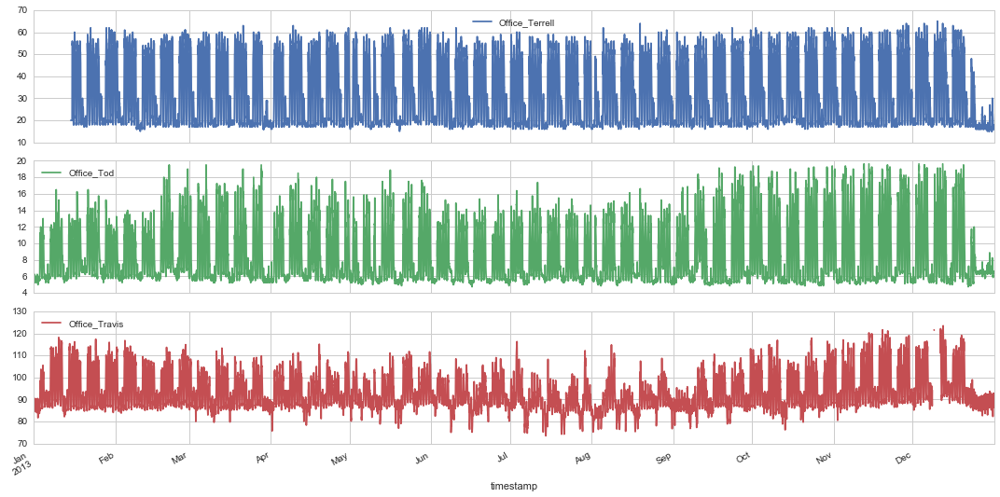

Plotting Office with start time: 2014-05-01T00:00:00.000000000
This includes the following buildings: ['Office_Mada', 'Office_Madeleine', 'Office_Madisyn', 'Office_Malik', 'Office_Marc', 'Office_Marcia', 'Office_Marcus', 'Office_Marianne', 'Office_Marilyn', 'Office_Marion', 'Office_Mark', 'Office_Marla', 'Office_Marlon', 'Office_Martha', 'Office_Martin', 'Office_Marvin', 'Office_Mary', 'Office_Maryann', 'Office_Mason', 'Office_Mat', 'Office_Matthew', 'Office_Max', 'Office_Maximus', 'Office_Maya', 'Office_Megan', 'Office_Melinda', 'Office_Mercedes', 'Office_Michael', 'Office_Micheal', 'Office_Mick', 'Office_Mikayla', 'Office_Milton', 'Office_Mohammed', 'Office_Moises', 'Office_Monty', 'Office_Morgan', 'Office_Moses', 'Office_Muhammad', 'Office_Myron']


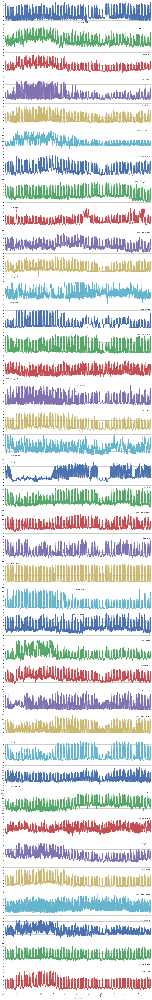

Plotting Office with start time: 2014-11-01T00:00:00.000000000
This includes the following buildings: ['Office_Natasha', 'Office_Nelson', 'Office_Noel']


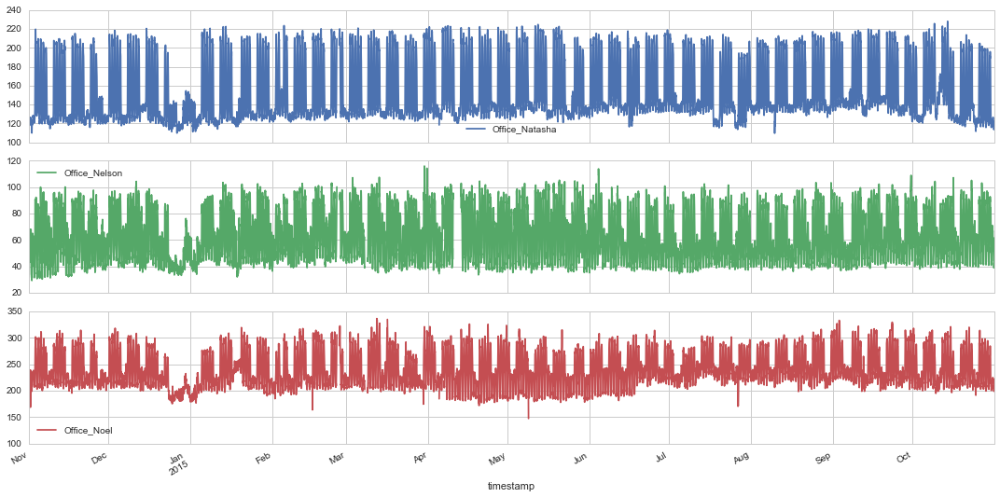

Plotting Office with start time: 2010-01-01T00:00:00.000000000
This includes the following buildings: ['Office_Dawn', 'Office_Dorian']


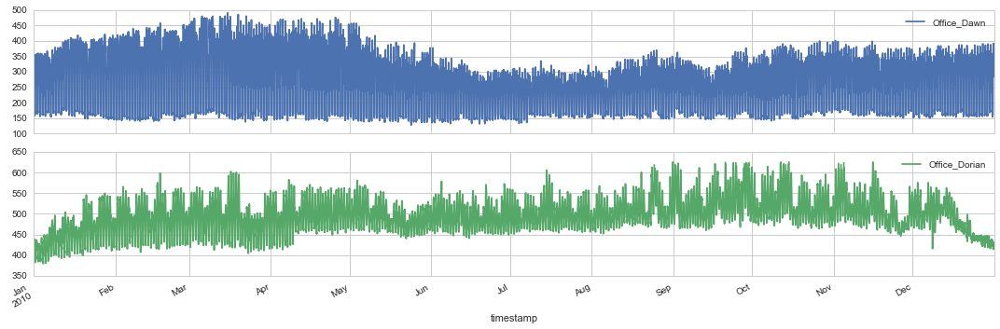

In [64]:
plot_buildingtype(meta, temp, "Office")